# **Final Evaluations : SMAI**

**Task : Visualizing and Understanding CNNs**

Authors :

    1. Alefiah Mubeen
    2. Ankita Maity
    3. Seshadri Mazumder
    4. Vivek Pareek

Assigned TA : Yashas Samaga

# **Code Organization**


1.   **Importing Headers**
2.   **Function for Convolution Module**
3.   **Function for De-Convolution Module**
4.   **Function for Image Normalisation**
5.   **Function for Loading Images**
6.   **Function for Create Model Hooks**
7.   **Function for Visualise Layer**
8.   **Function for Decode Predictions**
9.   **Functions for Visualisation of an Image**

# **Visualisations**

1.   **Module 1 : Normal Feature Visualisations.**

    *   Cat
    *   Ostrich
    *   Baboon
    *   Dog


2.   **Module 2 : Feature Visualisation for Image under Affine Transformations.**

    *   Cat
    *   Ostrich
    *   Baboon
    *   Dog


3.   **Module 3 : Feature Visualisation for Image under Occlusional Sensitivity.**



1.   **Corner Occlusion**

    *   Cat
    *   Ostrich
    *   Baboon
    *   Dog

1.   **Center Occlusion**

    *   Cat
    *   Ostrich
    *   Baboon
    *   Dog




**IMPORT HEADERS**

In [ ]:
import torch
import torch.nn as nn
from torch.autograd import Variable
from torchvision import models
from torchvision import transforms, utils

In [ ]:
import numpy as np
import scipy.misc
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import json
import pickle
import cv2
from functools import partial
import sys
from collections import OrderedDict
import os
import requests

# **CONVOLUTION**

In [ ]:
#VGG-16 ARCHITECTURE

class Vgg16Conv(nn.Module):

    def __init__(self, num_cls=1000):

        super(Vgg16Conv, self).__init__()
    
        self.features = nn.Sequential(

            # CONVOLUTION MODULE 1
            nn.Conv2d(3, 64, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2, return_indices=True),
            
            # CONVOLUTION MODULE 2
            nn.Conv2d(64, 128, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2, return_indices=True),

            # CONVOLUTION MODULE 3
            nn.Conv2d(128, 256, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2, return_indices=True),

            # CONVOLUTION MODULE 4
            nn.Conv2d(256, 512, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2, return_indices=True),

            # CONVOLUTION MODULE 5
            nn.Conv2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2, return_indices=True)
        )

        #CLASSIFICATION PART
        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(4096, num_cls),
            nn.Softmax(dim=1)
        )

        # INDEX OF CONVOLUTIONAL LAYERS
        self.conv_layer_indices = [0, 2, 5, 7, 10, 12, 14, 17, 19, 21, 24, 26, 28]

        # feature maps
        self.feature_maps = OrderedDict()
        # switch
        self.pool_locs = OrderedDict()
        # initial weight
        self.init_weights()

    def init_weights(self):

        #LOADING THE PRETRAINED VGG-16 MODEL
        vgg16_pretrained = models.vgg16(pretrained=True)
        
        #FEATURE MODULE
        #ITERATING THE FEATURES 
        for idx, layer in enumerate(vgg16_pretrained.features):

            #CHECKING IF THE LAYER IS A CONV2D LAYER
            if isinstance(layer, nn.Conv2d):

                #COPYING THE CONV2D WEIGHTS FROM THE MODEL TO THE DEFINED MODEL
                self.features[idx].weight.data = layer.weight.data

                #COPYING THE CONV2D BIAS FROM THE MODEL TO THE DEFINED MODEL
                self.features[idx].bias.data = layer.bias.data

        #CLASSIFIER MODULE
        #ITERATING THE FEATURES 
        for idx, layer in enumerate(vgg16_pretrained.classifier):
            
            #CHECKING IF THE LAYER IS A LINEAR LAYER
            if isinstance(layer, nn.Linear):

                #COPYING THE LINEAR WEIGHTS FROM THE MODEL TO THE DEFINED MODEL
                self.classifier[idx].weight.data = layer.weight.data

                #COPYING THE LINEAR BIAS FROM THE MODEL TO THE DEFINED MODEL
                self.classifier[idx].bias.data = layer.bias.data
    
    #VERIFIYING IF THE WEIGHTS AND BIASES ARE CORRECTLY COPIED
    def check(self):
        model = models.vgg16(pretrained=True)
        return model

    #x : DATA
    def forward(self, x):
        
        #ITERATING OVER THE LAYERS
        for idx, layer in enumerate(self.features):
            
            #IF THE LAYER IS A MAXPOOLING LAYER
            if isinstance(layer, nn.MaxPool2d):
                #GETTING THE LOCATION
                x, location = layer(x)
            else:
                x = layer(x)
        
        #FOR THE CLASSIFIER PARR
        # reshape to (1, 512 * 7 * 7)
        x = x.view(x.size()[0], -1)
        output = self.classifier(x)
        return output

if __name__ == '__main__':
    model = models.vgg16(pretrained=True)
    print(model)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

# **DE-CONVOLUTION**

In [ ]:
#VGG-16 REVERSE ARCHITECTURE

class Vgg16Deconv(nn.Module):

    def __init__(self):
        super(Vgg16Deconv, self).__init__()

        self.features = nn.Sequential(
            # deconv1
            nn.MaxUnpool2d(2, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 512, 3, padding=1),

            # deconv2
            nn.MaxUnpool2d(2, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 512, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 256, 3, padding=1),
            
            # deconv3
            nn.MaxUnpool2d(2, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 256, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 256, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 3, padding=1),
            
            # deconv4
            nn.MaxUnpool2d(2, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 128, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 3, padding=1),
            
            # deconv5
            nn.MaxUnpool2d(2, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 64, 3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 3, padding=1)    
        )

        #MAPPING OF CONVOLUTION LAYERS FROM VGG-16-TRANSPOSE TO VGG-16
        self.conv2deconv_indices = {
                0:30, 2:28, 5:25, 7:23,
                10:20, 12:18, 14:16, 17:13,
                19:11, 21:9, 24:6, 26:4, 28:2
                }

        #MAPPING OF MAXPOOLING LAYERS FROM VGG-16-TRANSPOSE TO VGG-16
        self.unpool2pool_indices = {
                26:4, 21:9, 14:16, 7:23, 0:30
                }

        self.init_weight()

    def init_weight(self):

        #LOADING THE PRETRAINED MODEL
        vgg16_pretrained = models.vgg16(pretrained=True)

        #TRAVERSING THE VGG-16 FEATURES
        for idx, layer in enumerate(vgg16_pretrained.features):
            
            #CHECKING IF THE LAYER IS A CONV2D LAYER
            if isinstance(layer, nn.Conv2d):

                #COPYING THE CONV2D WEIGHTS FROM THE MODEL TO THE INVERTED MODEL
                self.features[self.conv2deconv_indices[idx]].weight.data = layer.weight.data
                
                #COPYING THE CONV2D BIAS FROM THE MODEL TO THE INVERTED MODEL
                #self.features[self.conv2deconv_indices[idx]].bias.data = layer.bias.data
        
    #INPUT : DATA, LAYER_NUMBER, 
    def forward(self, x, layer, activation_idx, pool_locs):
        
        #CHECKING IF THE LAYER IS A CONVOLUTION LAYER
        if layer in self.conv2deconv_indices:
            start_idx = self.conv2deconv_indices[layer]
        else:
            raise ValueError("Layer is not a Convolutional Feature Map.")

        #ITERATING FROM THE GIVEN START INDEX

        for idx in range(start_idx, len(self.features)):
            
            #CHECKING IF IT IS A MAXPOOLING LAYER
            if isinstance(self.features[idx], nn.MaxUnpool2d):
                
                #PERFORMING THE UNPOOLING FROM PARTICULAR INDEX
                x = self.features[idx](x, pool_locs[self.unpool2pool_indices[idx]])
            else:
                #ELSE GETTING ONLY THE OUTPUT
                x = self.features[idx](x)
        #RETURNING THE FEATURE VECTOR
        return x

**NORMALISE IMAGE**

In [ ]:
def normalise_img(img):

    transform = transforms.Compose([transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])])
    img = transform(img)
    return img

**LOAD IMAGE**

In [ ]:
def process_images(img):
    img = cv2.resize(img, (224, 224))
    img = normalise_img(img)
    img = torch.unsqueeze(img,0)
    return img

In [ ]:
def store(model):

    def hook(module, input, output, key):
        if isinstance(module, nn.MaxPool2d):
           model.feature_maps[key] = output[0]
           model.pool_locs[key] = output[1]
        else:
           model.feature_maps[key] = output
    
    for idx, layer in enumerate(model._modules.get('features')):    
        layer.register_forward_hook(partial(hook, key=idx))

In [ ]:
def visualise_layer(layer, vgg16_conv, vgg16_deconv):


    #NUMBER OF CHANNELS
    num_feat = vgg16_conv.feature_maps[layer].shape[1]

    #SETTING OTHER CHANNEL VALUES TO 0
    new_feat_map = vgg16_conv.feature_maps[layer].clone()

    #CHOOSE THE MAX ACTIVATION VALUE FOR ALL CHANNEL
    act_lst = []
    for i in range(0, num_feat):
        choose_map = new_feat_map[0, i, :, :]
        activation = torch.max(choose_map)
        act_lst.append(activation.item())

    act_lst = np.array(act_lst)

    #CHOOSE THE MAX ACTIVATION CHANNEL BASED ON MAX ACTIVATION VALUE    
    mark = np.argmax(act_lst)

    #COPYING THE CHANNEL WITH HIGHEST ACTIVATION MAP
    choose_map = new_feat_map[0, mark, :, :]
    
    #CHOOSING THE HIGHEST ACTIVATION MAP VALUE
    max_activation = torch.max(choose_map)
    
    #IF THE MAX ACTIVATION CHANNEL IS 0
    if mark == 0:
        #MAKE ALL OTHER CHANNELS 0 AFTER THE HIGHEST ACTIVATION CHANNEL
        new_feat_map[:, 1:, :, :] = 0
    else:
        #MAKE THE CHANNELS AFTER THE HIGHEST ACTIVATION CHANNEL AS 0
        new_feat_map[:, :mark, :, :] = 0

        #IF SIZE!=CHANNEL, MARK AS 0
        if mark != vgg16_conv.feature_maps[layer].shape[1] - 1:
            new_feat_map[:, mark + 1:, :, :] = 0

    #CHOOSING THE CHANNEL WITH MAXIMUM ACTIVATION
    choose_map = torch.where(choose_map==max_activation,choose_map,torch.zeros(choose_map.shape))

    #COPYING THE CHOSEN MAP
    new_feat_map[0, mark, :, :] = choose_map
    
    #PRINTING THE MAX ACTIVATION
    #print(max_activation)
    
    #CALLING THE DE-CONVOLUTION MODULE 
    deconv_output = vgg16_deconv(new_feat_map, layer, mark, vgg16_conv.pool_locs)

    #TRANSPOSING TO BRING THE IMAGE INTO A H X W X C SHAPE
    new_img = deconv_output.data.numpy()[0].transpose(1, 2, 0)  # (H, W, C)
    
    #NORMALIZE
    new_img = (new_img - new_img.min()) / (new_img.max() - new_img.min()) * 255
    new_img = new_img.astype(np.uint8)

    return new_img, int(max_activation)

In [ ]:
def decode_predictions(preds, top=5):

    class_index_path = 'https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json'

    class_index_dict = None

    if len(preds.shape) != 2 or preds.shape[1] != 1000:
        raise ValueError('`decode_predictions` expects a batch of predciton'
        '(i.e. a 2D array of shape (samples, 1000)).'
        'Found array with shape: ' + str(preds.shape)
        )

    if not os.path.exists('/content/imagenet_class_index.json'):
        r = requests.get(class_index_path).content
        with open('/content/imagenet_class_index.json', 'w+') as f:
            f.write(r.content)
    with open('/content/imagenet_class_index.json') as f:
        class_index_dict = json.load(f)

    results = []
    for pred in preds:
        top_value, top_indices = torch.topk(pred, top)
        result = [tuple(class_index_dict[str(i.item())]) + (pred[i].item(),) \
                for i in top_indices]
        result = [tuple(class_index_dict[str(i.item())]) + (j.item(),) \
        for (i, j) in zip(top_indices, top_value)]
        results.append(result)

    return results

In [ ]:
def visualise_for_image(img):

    img_orig = img
    img = process_images(img)
    vgg16_conv = Vgg16Conv()
    vgg16_conv.eval()
    store(vgg16_conv)
    conv_output = vgg16_conv(img)
    pool_locs = vgg16_conv.pool_locs

    print('Predicted:', decode_predictions(conv_output, top=1)[0])

    vgg16_deconv = Vgg16Deconv()
    vgg16_deconv.eval()
    plt.figure(figsize=(40,40), dpi=80)
    img = cv2.resize(img_orig, (224, 224))
    plt.subplot(4,4,1)
    plt.imshow(img[:,:,::-1])
    plt.title("Original")
    plt.axis("off")
    i=2
    #for idx, layer in enumerate([0, 2, 5, 7, 10, 12, 14, 17, 19, 21, 24, 26, 28]):
    for idx, layer in enumerate(vgg16_conv.conv_layer_indices):        
        img, activation = visualise_layer(layer, vgg16_conv, vgg16_deconv)
        plt.subplot(4,4,i)
        plt.title(f'Layer : {layer} Channel Number : {activation}')
        plt.imshow(img)
        plt.axis("off")
        i+=1
    plt.show()

# **MODULE 1 : NORMAL FEATURE VISUALISATION**

# **CAT**

Predicted: [('n02123045', 'tabby', 0.4848901331424713)]


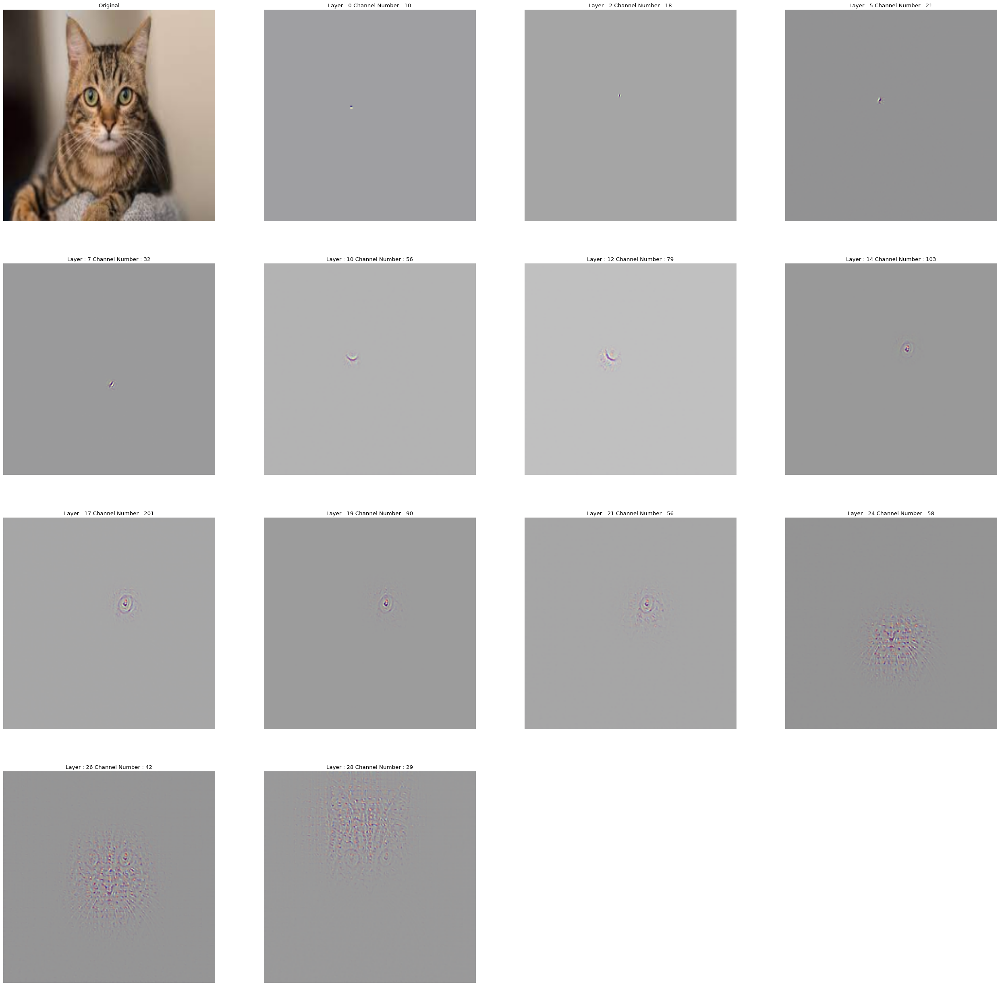

In [ ]:
img_path = "/content/CAT.jpeg"
img = cv2.imread(img_path)
visualise_for_image(img)

# **OSTRICH**

Predicted: [('n01518878', 'ostrich', 0.99989914894104)]


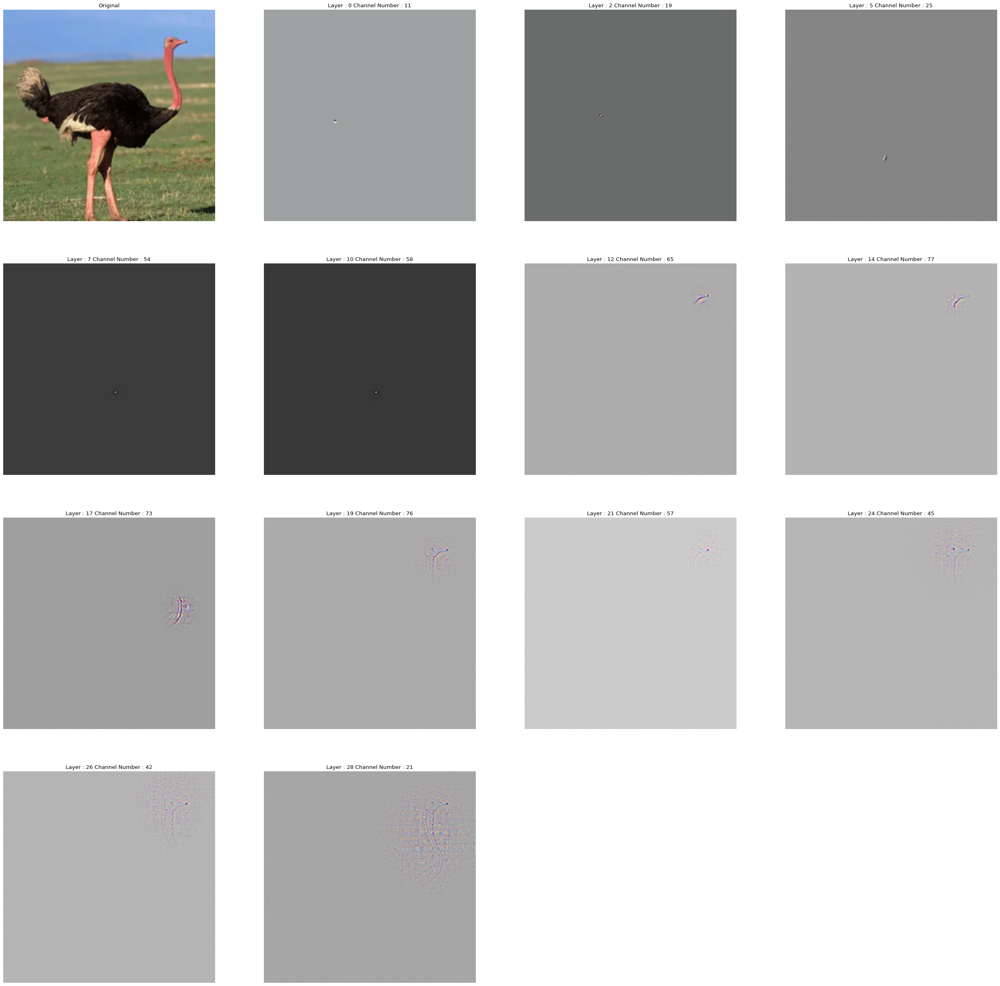

In [ ]:
img_path = "/content/OSTRICH.webp"
img = cv2.imread(img_path)
visualise_for_image(img)

# **BABOON**

Predicted: [('n02486410', 'baboon', 0.9334109425544739)]


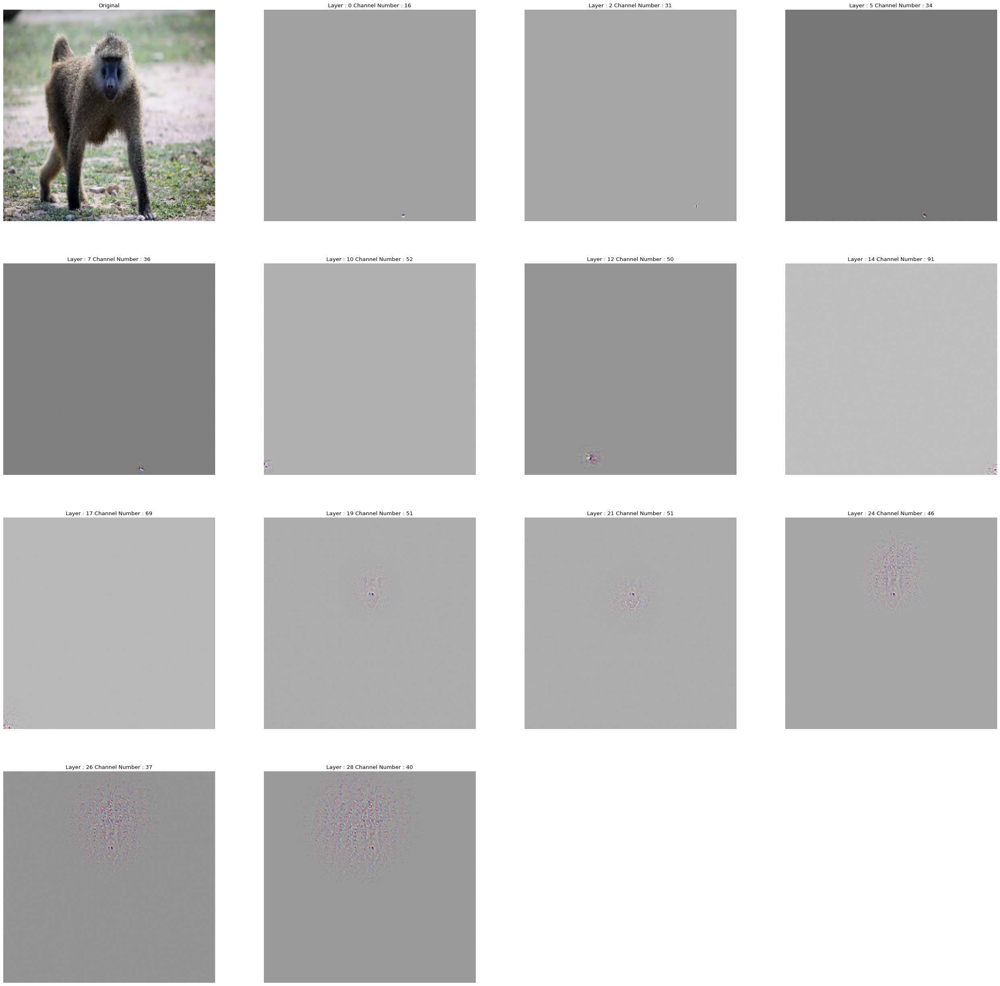

In [ ]:
img_path = "/content/BABOON.jpg"
img = cv2.imread(img_path)
visualise_for_image(img)

# **DOG**

Predicted: [('n02106662', 'German_shepherd', 0.6498004198074341)]


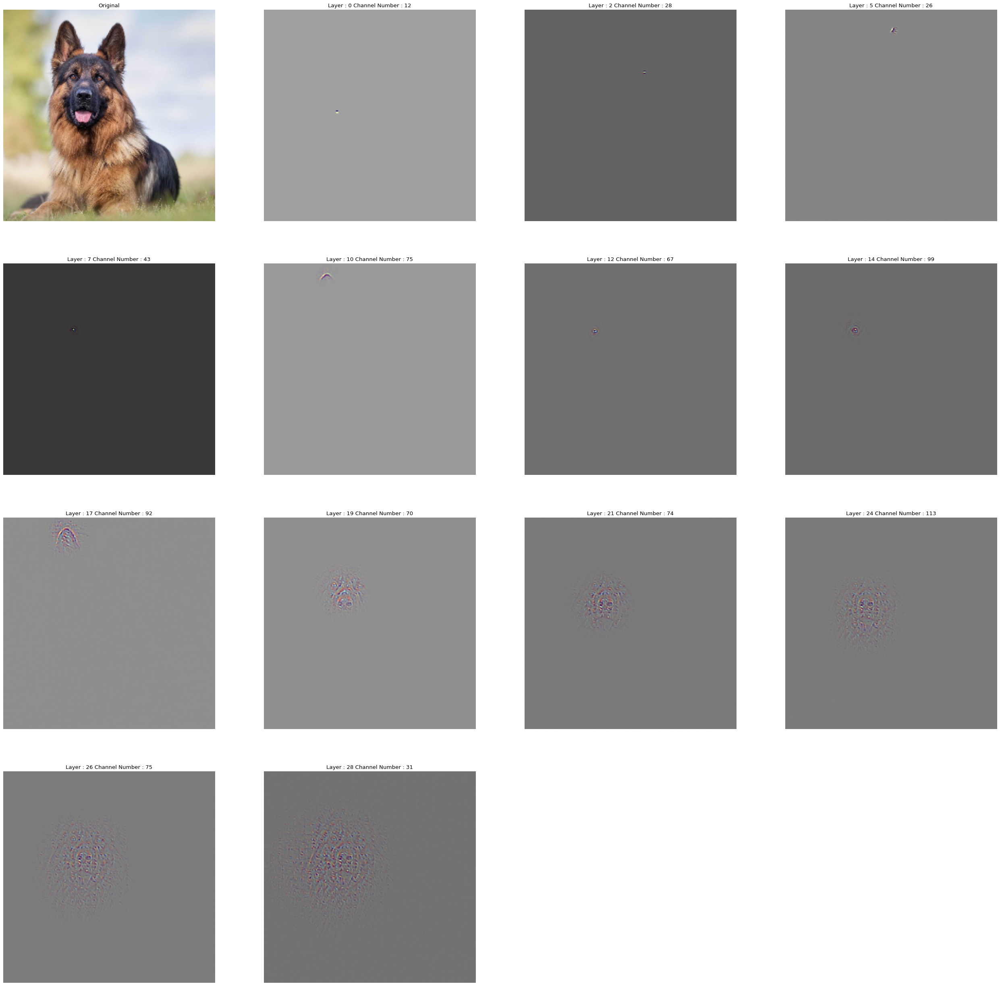

In [ ]:
img_path = "/content/DOG.jpg"
img = cv2.imread(img_path)
visualise_for_image(img)

# **MODULE 2 : FEATURE INVARIANCE**

# **CAT**

Predicted: [('n02123045', 'tabby', 0.42133060097694397)]


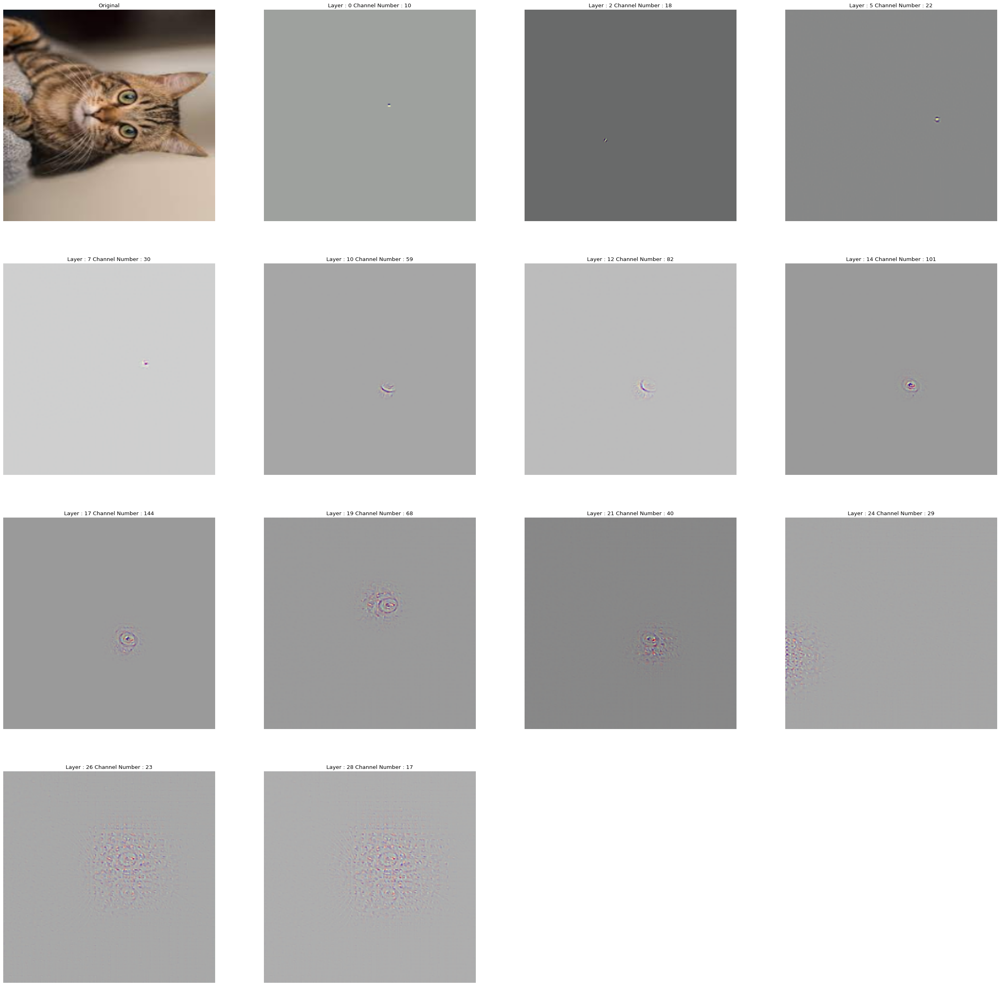

In [ ]:
img_path = "/content/CAT.jpeg"
img = cv2.imread(img_path)
img = cv2.rotate(img, cv2.cv2.ROTATE_90_CLOCKWISE)
visualise_for_image(img)

# **OSTRICH**

Predicted: [('n02483708', 'siamang', 0.20317254960536957)]


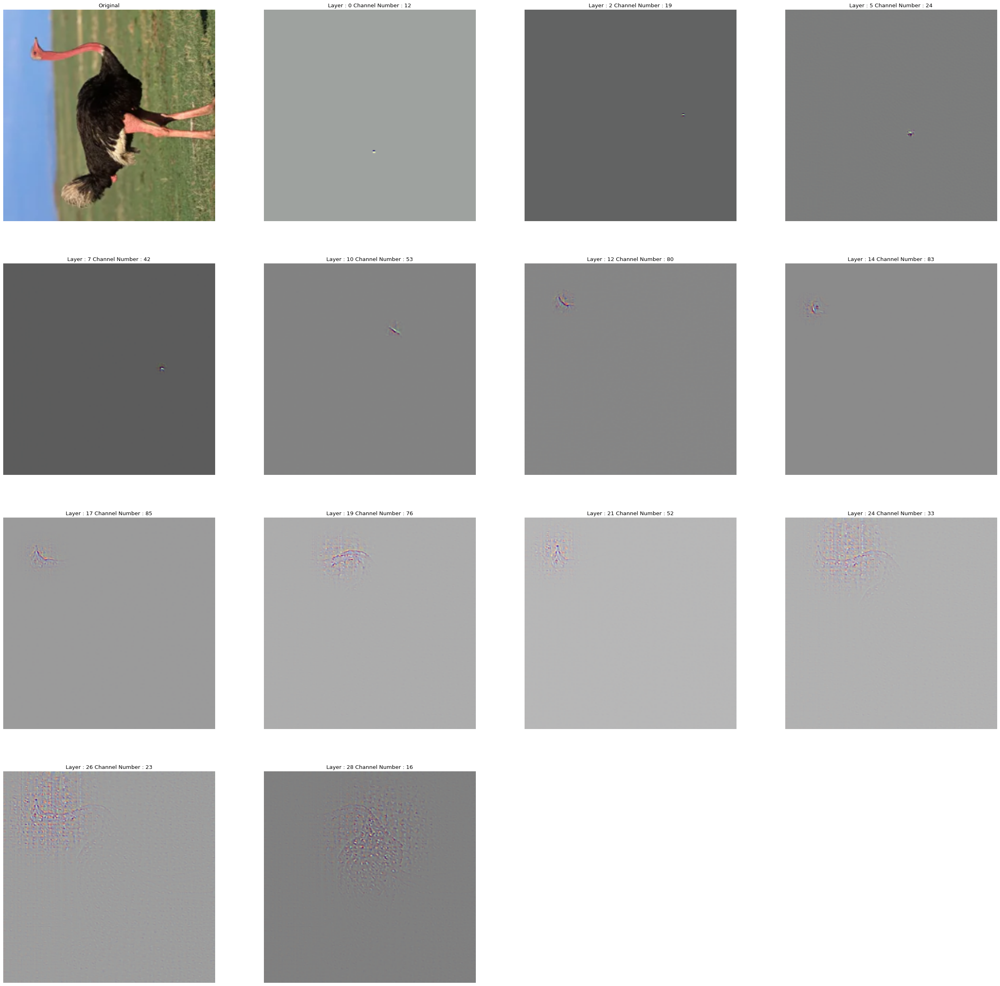

In [ ]:
img_path = "/content/OSTRICH.webp"
img = cv2.imread(img_path)
img = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
visualise_for_image(img)

# **BABOON**

Predicted: [('n02493793', 'spider_monkey', 0.35989752411842346)]


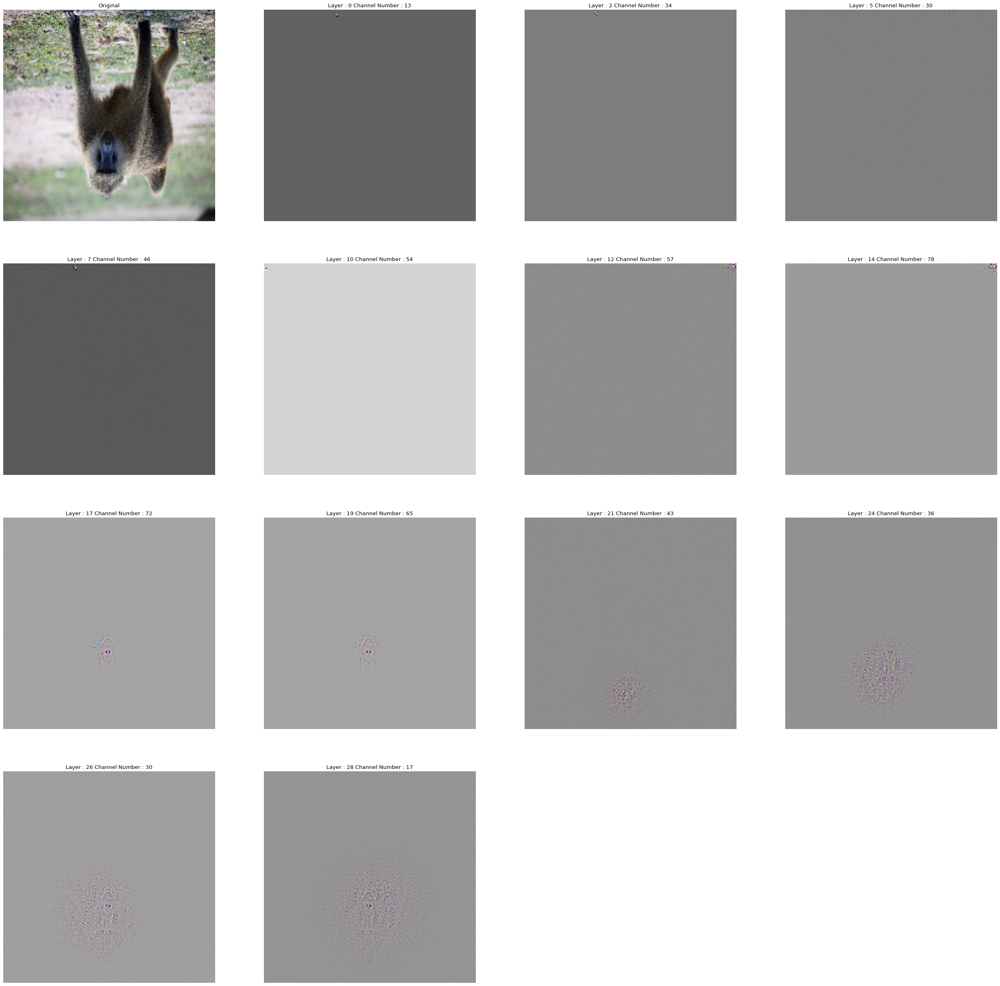

In [ ]:
img_path = "/content/BABOON.jpg"
img = cv2.imread(img_path)
img = cv2.rotate(img, cv2.cv2.ROTATE_90_CLOCKWISE)
img = cv2.rotate(img, cv2.cv2.ROTATE_90_CLOCKWISE)
visualise_for_image(img)

# **DOG**

Predicted: [('n02484975', 'guenon', 0.38161760568618774)]


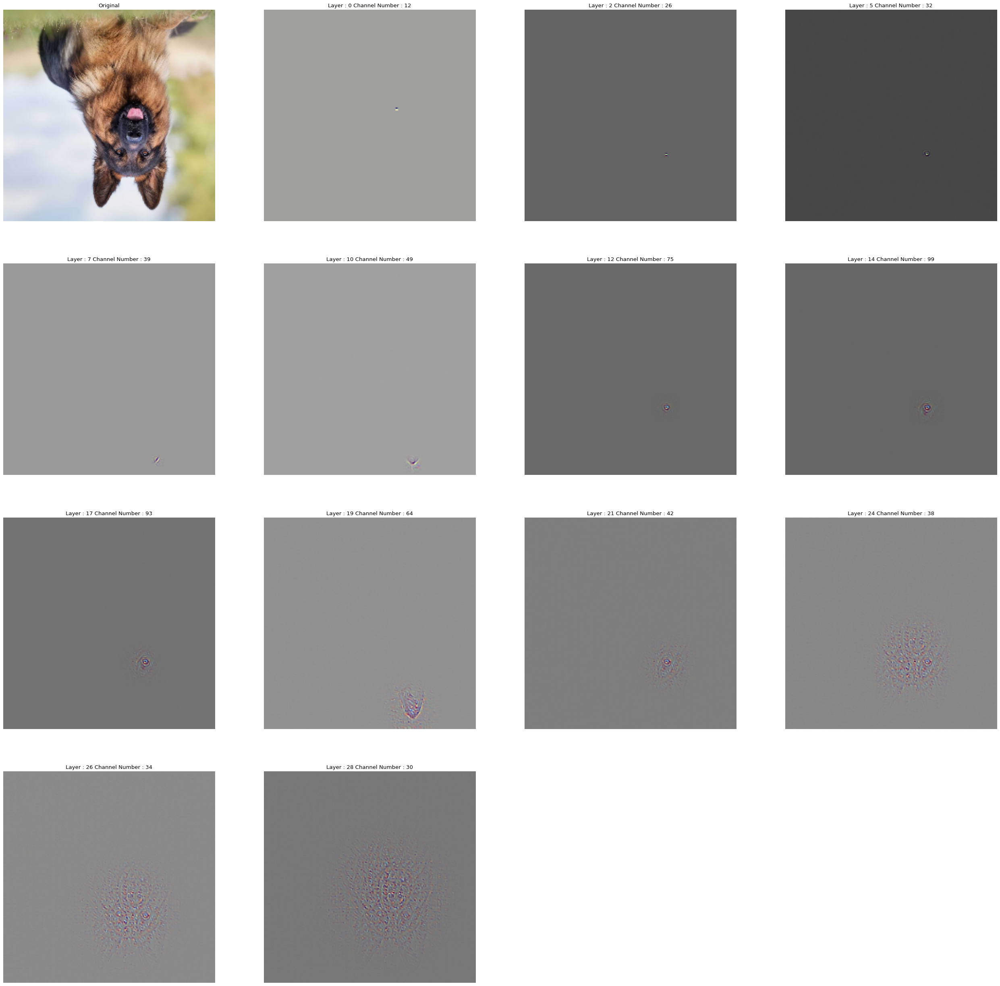

In [ ]:
img_path = "/content/DOG.jpg"
img = cv2.imread(img_path)
img = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
img = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
visualise_for_image(img)

# **MODULE 3 : OCCLUSIONAL SENSITIVITY**

# **CAT corners occluded**

Predicted: [('n02124075', 'Egyptian_cat', 0.4861030876636505)]


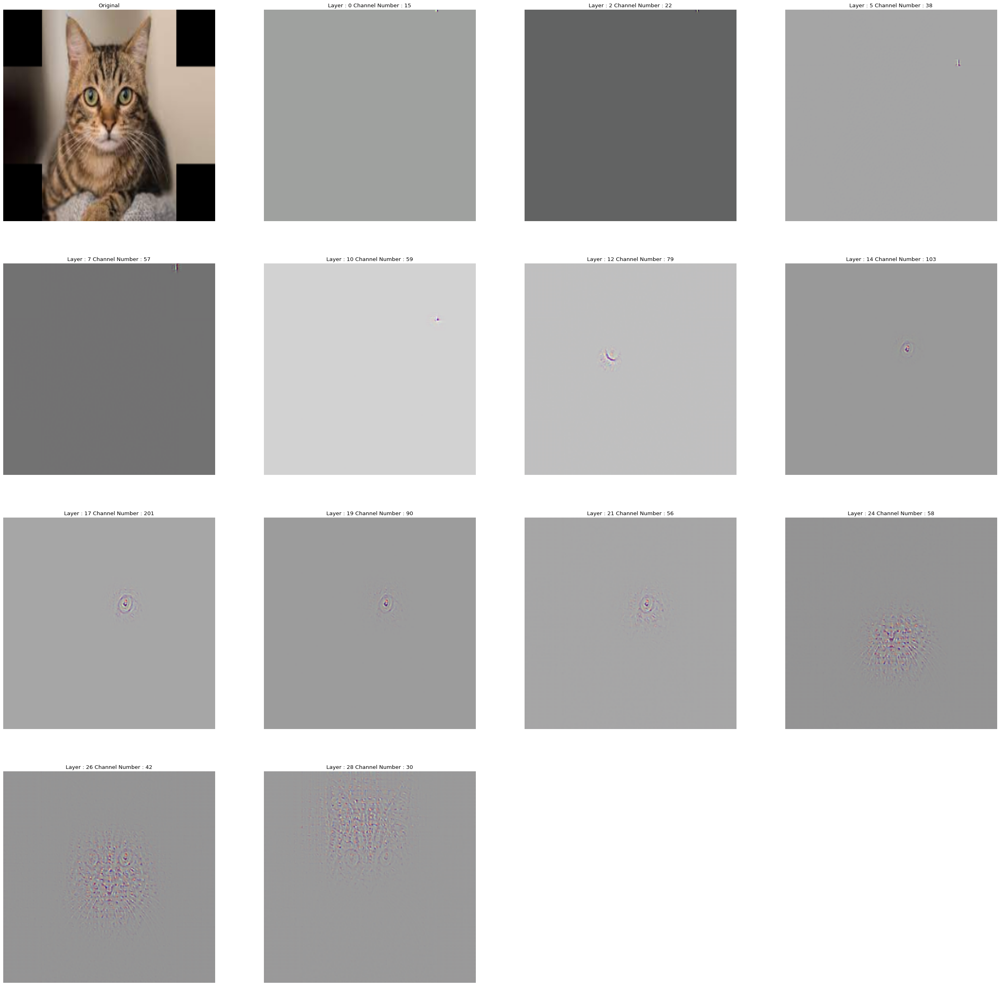

In [ ]:
img_path = "/content/CAT.jpeg"
img = cv2.imread(img_path)
img[:50,:50,:] = 0
img[:50,-50:,:] = 0
img[-50:,:50,:] = 0
img[-50:,-50:,:] = 0
visualise_for_image(img)

# **CAT center occluded**

Predicted: [('n02124075', 'Egyptian_cat', 0.23479969799518585)]


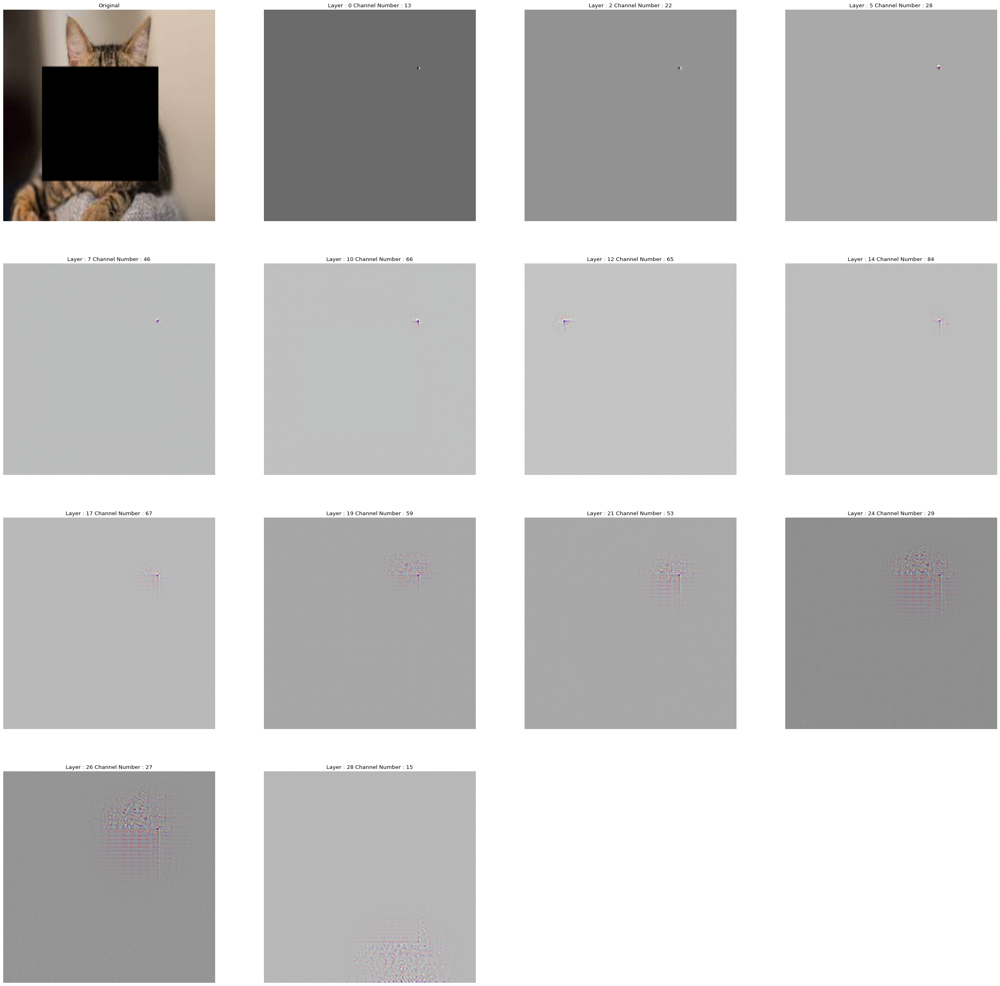

In [ ]:
img_path = "/content/CAT.jpeg"
img = cv2.imread(img_path)
img[50:150,50:200,:] = 0
visualise_for_image(img)

# **OSTRICH corners occluded**

Predicted: [('n01518878', 'ostrich', 0.9995567202568054)]


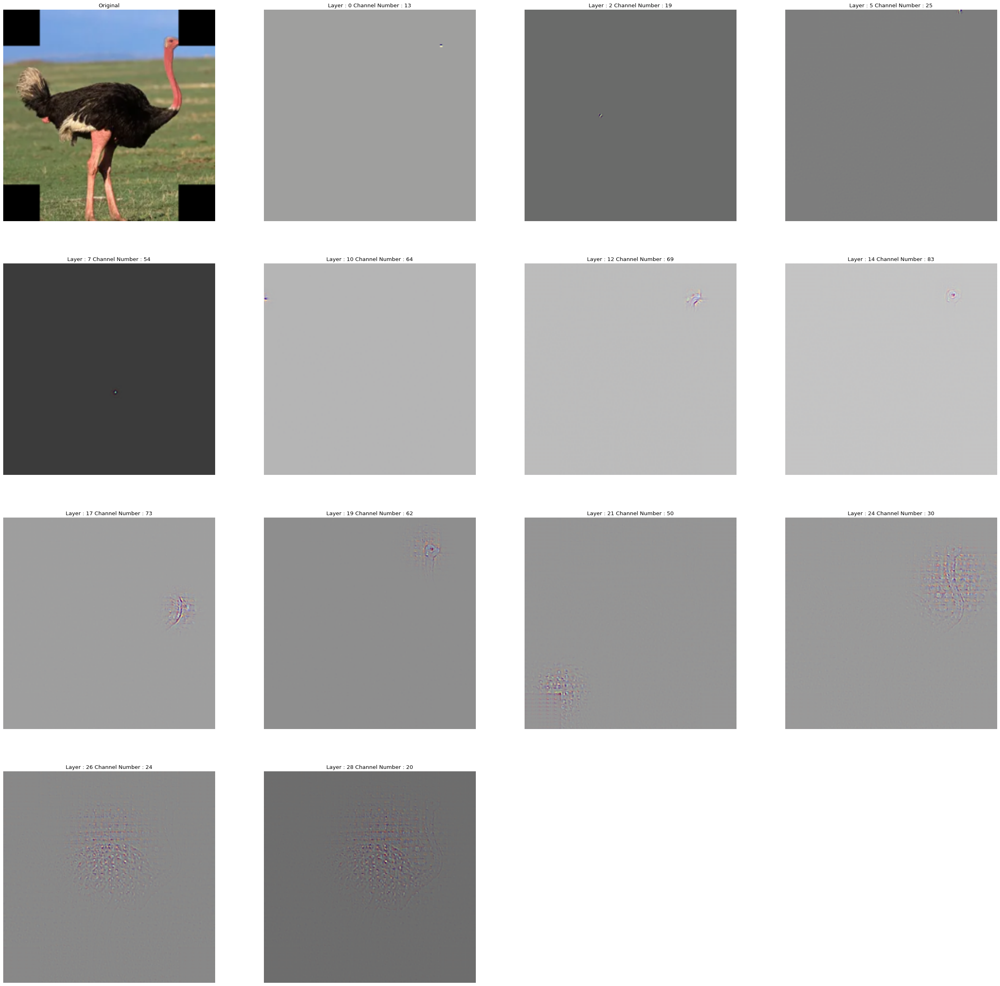

In [ ]:
img_path = "/content/OSTRICH.webp"
img = cv2.imread(img_path)
img[:50,:50,:] = 0
img[:50,-50:,:] = 0
img[-50:,:50,:] = 0
img[-50:,-50:,:] = 0
visualise_for_image(img)

# **OSTRICH center occluded**

Predicted: [('n01518878', 'ostrich', 0.9991137385368347)]


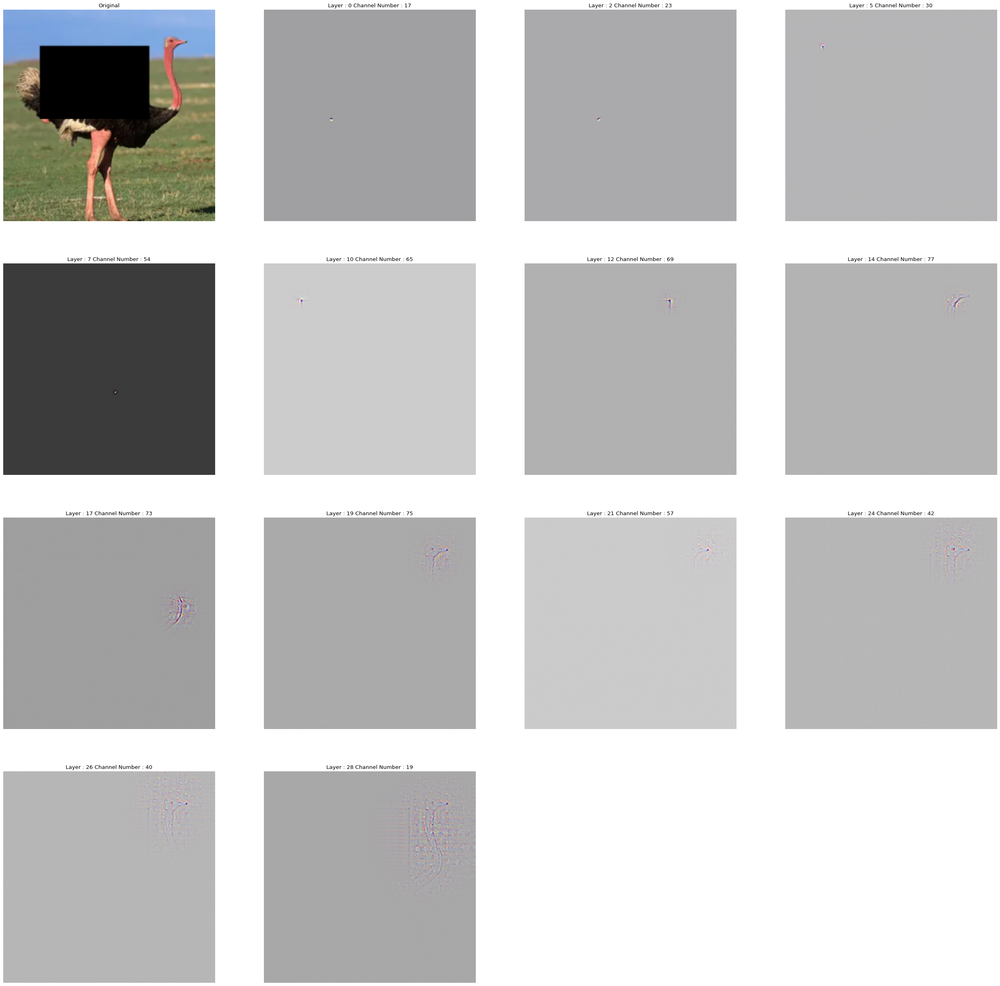

In [ ]:
img_path = "/content/OSTRICH.webp"
img = cv2.imread(img_path)
img[50:150,50:200,:] = 0
visualise_for_image(img)

# **BABOON corners occluded**

Predicted: [('n02486410', 'baboon', 0.9284234642982483)]


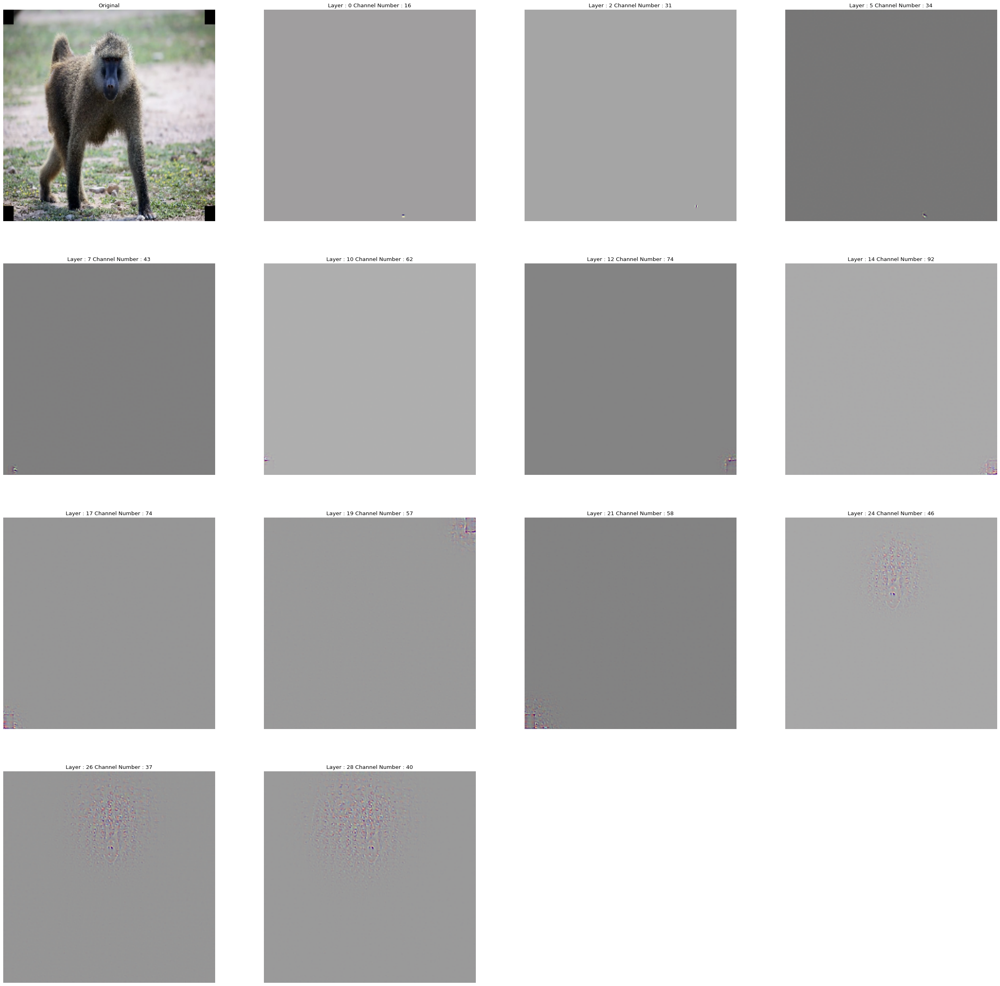

In [ ]:
img_path = "/content/BABOON.jpg"
img = cv2.imread(img_path)
img[:50,:50,:] = 0
img[:50,-50:,:] = 0
img[-50:,:50,:] = 0
img[-50:,-50:,:] = 0
visualise_for_image(img)

# **BABOON center occluded**

Predicted: [('n02486410', 'baboon', 0.6603912115097046)]


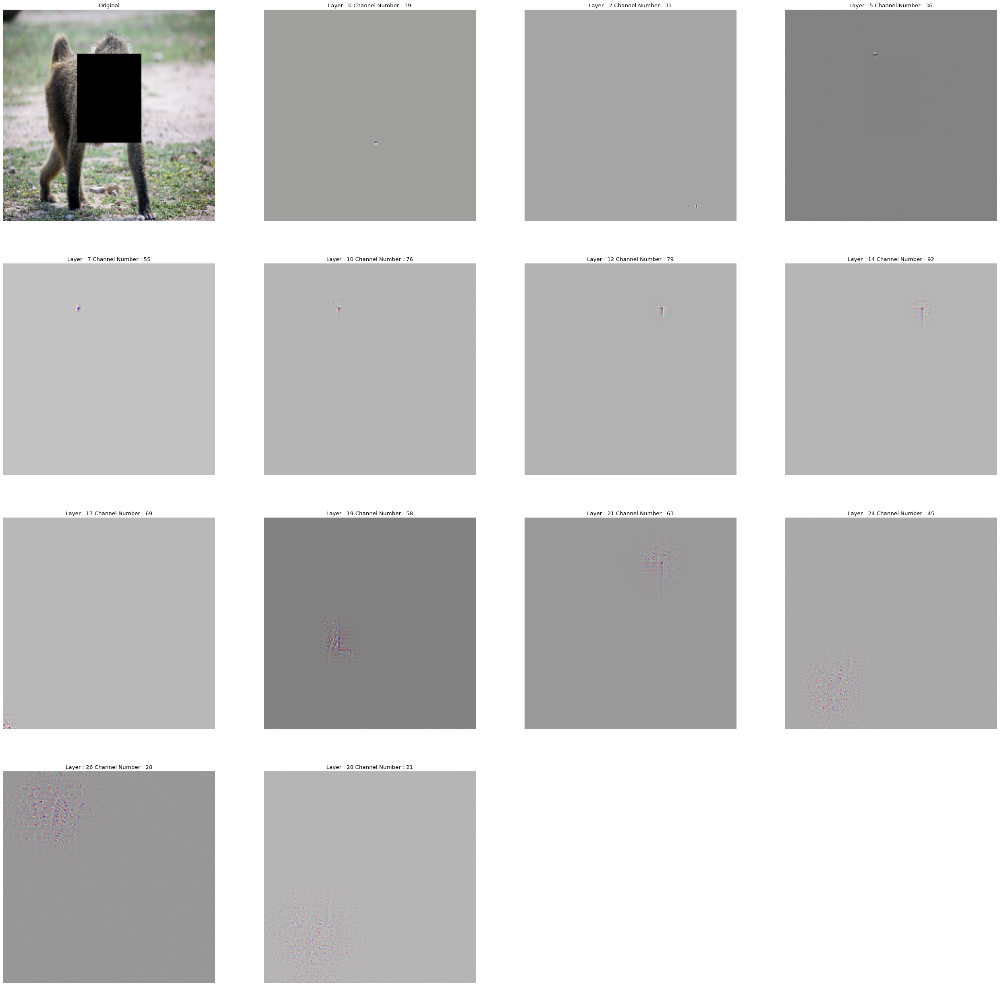

In [ ]:
img_path = "/content/BABOON.jpg"
img = cv2.imread(img_path)
img[150:450,350:650,:] = 0
visualise_for_image(img)

# **DOG corners occluded**

Predicted: [('n02106662', 'German_shepherd', 0.6639654636383057)]


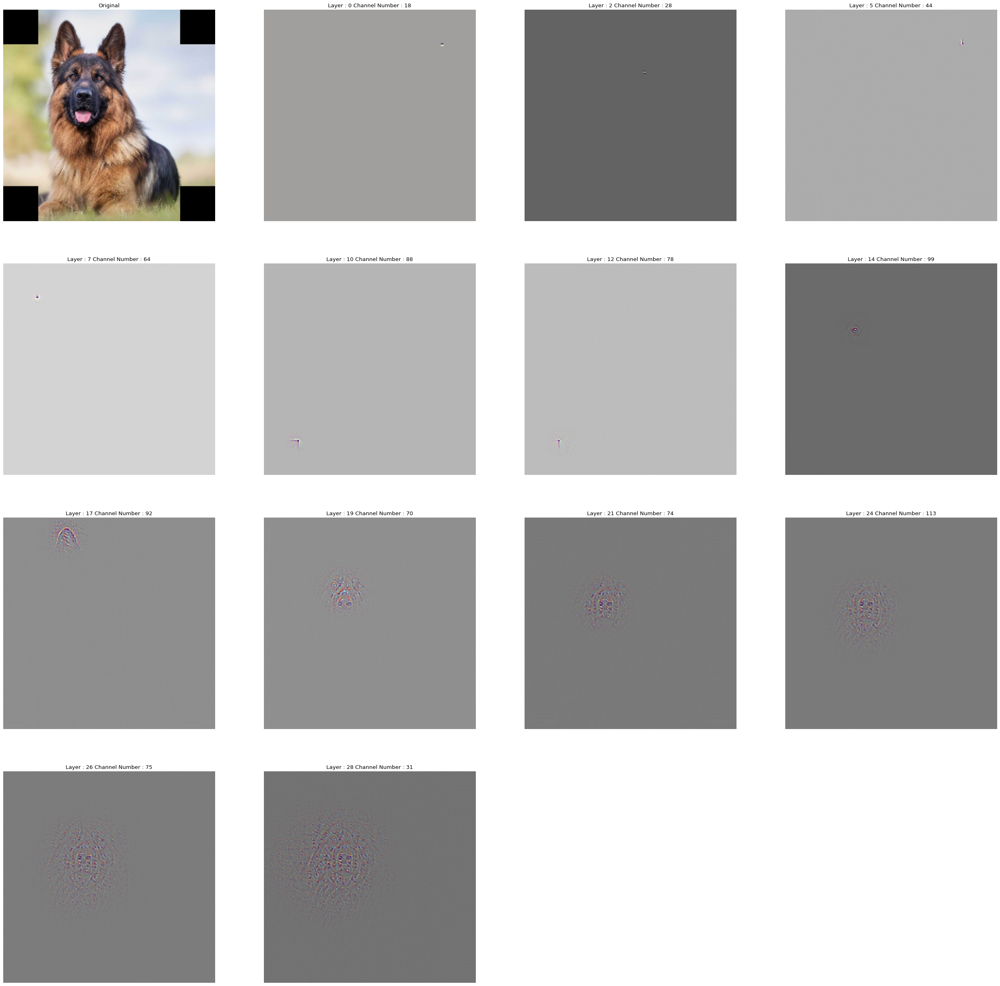

In [ ]:
img_path = "/content/DOG.jpg"
img = cv2.imread(img_path)
img[:200,:200,:] = 0
img[:200,-200:,:] = 0
img[-200:,:200,:] = 0
img[-200:,-200:,:] = 0
visualise_for_image(img)

# **DOG center occluded**

Predicted: [('n02106662', 'German_shepherd', 0.19697290658950806)]


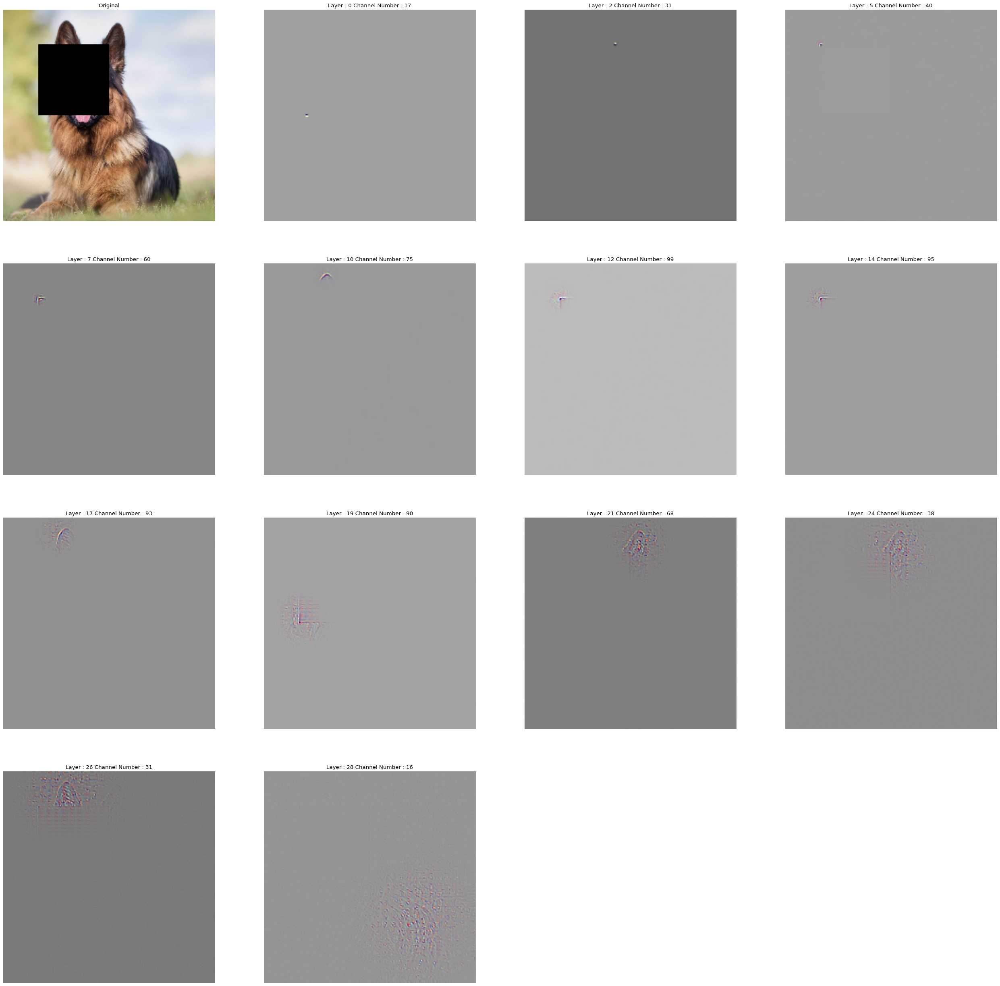

In [ ]:
img_path = "/content/DOG.jpg"
img = cv2.imread(img_path)
img[200:600,200:600,:] = 0
visualise_for_image(img)